# Atividade 8
# Discente: Victor Gabriel Ferreira Barbosa

In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
from imblearn.under_sampling import RandomUnderSampler
import seaborn as sb
from lime.lime_tabular import LimeTabularExplainer


# Lendo base de dados

In [2]:
churn_df = pd.read_csv("Churn_Modelling.csv")

In [3]:
churn_df

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9996,15606229,Obijiaku,771,France,Male,39,5,0.00,2,1,0,96270.64,0
9996,9997,15569892,Johnstone,516,France,Male,35,10,57369.61,1,1,1,101699.77,0
9997,9998,15584532,Liu,709,France,Female,36,7,0.00,1,0,1,42085.58,1
9998,9999,15682355,Sabbatini,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1


# Preparando os dados

Fonte: https://www.kaggle.com/datasets/shrutimechlearn/churn-modelling/data

## Conjunto de dados de Churn de clientes de um banco

- RowNumber: Número da linha no arquivo.
- CustomerId: Identificador unico para cada cliente do banco.
- Surname: Último nome do cliente.
- CreditScore: Pontuação de crédito do cliente.
- Geography: O pais no qual o cliente reside.
- Gender: Gênero.
- Age: idade.
- Tenure: Número de anos que o cliente utiliza serviços do banco.
- Balance: Saldo bancário do cliente.
- NumOfProducts: Número de produtos do banco que o cliente esta utilizando.
- HasCrCard: Se o cliente possui um cartão de credito do banco.
- IsActiveMember: Se o cliente é um membro ativo.
- EstimatedSalary: Salario estimado do cliente em dolares.
- Exited: Se o cliente encerrou a conta com o banco (Churn).

## Transformando variaveis categoricas

In [4]:
gender_one_hot = pd.get_dummies(churn_df["Gender"], drop_first=True)

In [5]:
churn_df = churn_df.drop(columns=["Gender"])

In [6]:
churn_df["Male"] = gender_one_hot["Male"]

In [7]:
geo_one_hot = pd.get_dummies(churn_df["Geography"], drop_first=True)

In [8]:
churn_df = churn_df.drop(columns=["Geography"])

In [9]:
churn_df["Germany"] = geo_one_hot["Germany"]
churn_df["Spain"] = geo_one_hot["Spain"]

In [10]:
churn_df

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Male,Germany,Spain
0,1,15634602,Hargrave,619,42,2,0.00,1,1,1,101348.88,1,0,0,0
1,2,15647311,Hill,608,41,1,83807.86,1,0,1,112542.58,0,0,0,1
2,3,15619304,Onio,502,42,8,159660.80,3,1,0,113931.57,1,0,0,0
3,4,15701354,Boni,699,39,1,0.00,2,0,0,93826.63,0,0,0,0
4,5,15737888,Mitchell,850,43,2,125510.82,1,1,1,79084.10,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9996,15606229,Obijiaku,771,39,5,0.00,2,1,0,96270.64,0,1,0,0
9996,9997,15569892,Johnstone,516,35,10,57369.61,1,1,1,101699.77,0,1,0,0
9997,9998,15584532,Liu,709,36,7,0.00,1,0,1,42085.58,1,0,0,0
9998,9999,15682355,Sabbatini,772,42,3,75075.31,2,1,0,92888.52,1,1,1,0


## Removendo campos dispensaveis para o treinamento

As features abaixo são apenas identificadores para cada consumidor e não agregam informação na classificação.

In [11]:
churn_df = churn_df.drop(columns=["CustomerId", "Surname", "RowNumber"])

In [12]:
churn_df

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Male,Germany,Spain
0,619,42,2,0.00,1,1,1,101348.88,1,0,0,0
1,608,41,1,83807.86,1,0,1,112542.58,0,0,0,1
2,502,42,8,159660.80,3,1,0,113931.57,1,0,0,0
3,699,39,1,0.00,2,0,0,93826.63,0,0,0,0
4,850,43,2,125510.82,1,1,1,79084.10,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,39,5,0.00,2,1,0,96270.64,0,1,0,0
9996,516,35,10,57369.61,1,1,1,101699.77,0,1,0,0
9997,709,36,7,0.00,1,0,1,42085.58,1,0,0,0
9998,772,42,3,75075.31,2,1,0,92888.52,1,1,1,0


## Analise de correlação

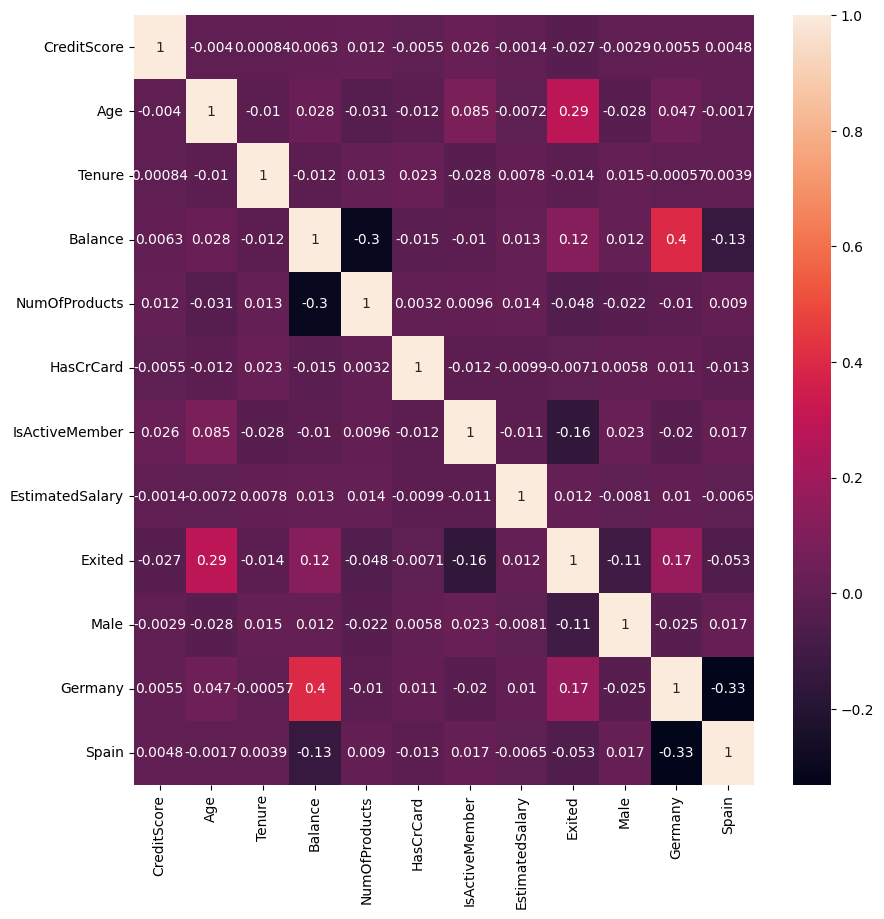

In [13]:
plt.figure(figsize=(10, 10))
dataplot = sb.heatmap(churn_df.corr(), annot=True)
plt.show()

As features não possuem uma alta correlação entre si, logo serão mantidas.

## Separando treino e teste

In [14]:
X = churn_df.drop(columns=["Exited"])
Y = churn_df["Exited"]

X_train, X_test, Y_train, Y_test = train_test_split(
    X, Y, test_size=0.33, random_state=55
)

## Undersampling

A base de dados é desbalanceada, desta forma será utilizado a tecnica de undersampling na classe majoritaria.

In [15]:
undersample = RandomUnderSampler(sampling_strategy="majority", random_state=55)

In [16]:
X_train, Y_train = undersample.fit_resample(X_train, Y_train)

In [17]:
Y_train.value_counts()

0    1371
1    1371
Name: Exited, dtype: int64

## Escalonando os dados

Por utilizar modelos como a rede neural, será necessaria realizar o escalonamento dos dados de modo a obter melhores resultados.

In [18]:
from sklearn.preprocessing import StandardScaler  

scaler = StandardScaler()  

X_train_scaled = scaler.fit_transform(X_train)


# Treinando Modelos

## Árvore de decisão

### Obtendo melhores hiperparâmetros

In [325]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier

tree_params = {'criterion':['gini','entropy'],'max_depth':[4,5,6,7,8,9,10,11,12,15,20,30,40,50,70,90,120,150,200]}

dt_model = DecisionTreeClassifier(random_state = 10)

clf = GridSearchCV(dt_model, tree_params, cv=5, n_jobs=-1,scoring = "f1")

In [326]:
clf.fit(X_train_scaled, Y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=10), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 5, 6, 7, 8, 9, 10, 11, 12, 15, 20, 30,
                                       40, 50, 70, 90, 120, 150, 200]},
             scoring='f1')

In [327]:
clf.best_params_

{'criterion': 'entropy', 'max_depth': 7}

In [328]:
dt_best_params = {'criterion': 'entropy', 'max_depth': 7}

### Treinando

In [329]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

dt_model = DecisionTreeClassifier(**dt_best_params, random_state = 10)

dt_pipe = Pipeline([('dt', dt_model)])

dt_pipe.fit(X_train, Y_train)

Pipeline(steps=[('dt',
                 DecisionTreeClassifier(criterion='entropy', max_depth=7,
                                        random_state=10))])

In [330]:
Y_pred_dt = dt_pipe.predict(X_test)
Y_pred_dt_proba = dt_pipe.predict_proba(X_test)

In [331]:
print(classification_report(Y_test, Y_pred_dt))

              precision    recall  f1-score   support

           0       0.92      0.76      0.83      2634
           1       0.43      0.74      0.55       666

    accuracy                           0.75      3300
   macro avg       0.68      0.75      0.69      3300
weighted avg       0.82      0.75      0.77      3300



In [324]:
print(classification_report(Y_test, Y_pred_dt))

              precision    recall  f1-score   support

           0       0.92      0.76      0.83      2634
           1       0.43      0.74      0.55       666

    accuracy                           0.75      3300
   macro avg       0.68      0.75      0.69      3300
weighted avg       0.82      0.75      0.77      3300



## KNN

### Obtendo melhores hiperparâmetros

In [27]:
from sklearn.neighbors import KNeighborsClassifier

knn_params = {
    'n_neighbors' : range(1, 30),
    'weights': ['uniform', 'distance']
}

knn_model = KNeighborsClassifier()

clf = GridSearchCV(knn_model, knn_params, cv=5, n_jobs=-1,scoring = "f1")

In [28]:
clf.fit(X_train_scaled, Y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': range(1, 30),
                         'weights': ['uniform', 'distance']},
             scoring='f1')

In [29]:
clf.best_params_

{'n_neighbors': 24, 'weights': 'distance'}

In [30]:
knn_best_params = {'n_neighbors': 24, 'weights': 'distance'}

### Treinando

In [31]:
knn_model = KNeighborsClassifier(**clf.best_params_)

knn_pipe = Pipeline([('scaler', StandardScaler()), ('knn', knn_model)])

knn_pipe.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('knn',
                 KNeighborsClassifier(n_neighbors=24, weights='distance'))])

In [32]:
Y_pred_knn = knn_pipe.predict(X_test)
Y_pred_knn_proba = knn_pipe.predict_proba(X_test)

In [33]:
print(classification_report(Y_test, Y_pred_knn))

              precision    recall  f1-score   support

           0       0.91      0.76      0.83      2634
           1       0.42      0.71      0.53       666

    accuracy                           0.75      3300
   macro avg       0.67      0.74      0.68      3300
weighted avg       0.81      0.75      0.77      3300



## Regressão logistica

### Obtendo melhores hiperparâmetros

In [34]:
from sklearn.linear_model import LogisticRegression
import numpy as np

lr_params = {
    'penalty' : ['l2'],
    'C' : np.logspace(-3,3,7),
    'solver' : ['newton-cholesky']
}

lr_model = LogisticRegression(random_state = 55)

clf = GridSearchCV(lr_model, lr_params, cv=5, n_jobs=-1, scoring = "f1")

In [35]:
clf.fit(X_train_scaled, Y_train)

GridSearchCV(cv=5, estimator=LogisticRegression(random_state=55), n_jobs=-1,
             param_grid={'C': array([1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03]),
                         'penalty': ['l2'], 'solver': ['newton-cholesky']},
             scoring='f1')

In [36]:
clf.best_params_

{'C': 10.0, 'penalty': 'l2', 'solver': 'newton-cholesky'}

In [37]:
lr_best_params = {'C': 10.0, 'penalty': 'l2', 'solver': 'newton-cholesky'}

### Obtendo melhores hiperparâmetros

In [38]:
lr_model = LogisticRegression(**clf.best_params_, random_state = 55)

lr_pipe = Pipeline([('scaler', StandardScaler()), ('lr', lr_model)])

lr_pipe.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('lr',
                 LogisticRegression(C=10.0, random_state=55,
                                    solver='newton-cholesky'))])

In [39]:
Y_pred_lr = lr_pipe.predict(X_test)
Y_pred_lr_proba = lr_pipe.predict_proba(X_test)

In [40]:
print(classification_report(Y_test, Y_pred_lr))

              precision    recall  f1-score   support

           0       0.91      0.71      0.80      2634
           1       0.39      0.72      0.50       666

    accuracy                           0.71      3300
   macro avg       0.65      0.72      0.65      3300
weighted avg       0.80      0.71      0.74      3300



## Rede Neural

### Obtendo melhores hiperparâmetros

In [41]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.neural_network import MLPClassifier

mlp_params = {'solver': ['lbfgs', 'sgd', 'adam'], 'max_iter': [1000,1100,1200,1300,1400,1500,1600,1700,1800,1900,2000 ], 'alpha': 10.0 ** -np.arange(1, 10), 'hidden_layer_sizes':np.arange(10, 15), 'random_state':[0,1,2,3,4,5,6,7,8,9]}

mlp_model = MLPClassifier()

clf = RandomizedSearchCV(mlp_model, mlp_params, cv=5, n_jobs=-1, scoring = "f1", n_iter=40)

In [42]:
clf.fit(X_train_scaled, Y_train)

RandomizedSearchCV(cv=5, estimator=MLPClassifier(), n_iter=40, n_jobs=-1,
                   param_distributions={'alpha': array([1.e-01, 1.e-02, 1.e-03, 1.e-04, 1.e-05, 1.e-06, 1.e-07, 1.e-08,
       1.e-09]),
                                        'hidden_layer_sizes': array([10, 11, 12, 13, 14]),
                                        'max_iter': [1000, 1100, 1200, 1300,
                                                     1400, 1500, 1600, 1700,
                                                     1800, 1900, 2000],
                                        'random_state': [0, 1, 2, 3, 4, 5, 6, 7,
                                                         8, 9],
                                        'solver': ['lbfgs', 'sgd', 'adam']},
                   scoring='f1')

In [54]:
# clf.best_params_

In [44]:
mlp_best_params = {'solver': 'adam',
 'random_state': 6,
 'max_iter': 1200,
 'hidden_layer_sizes': 14,
 'alpha': 1e-08}

### Treinando

In [45]:
mlp_model = MLPClassifier(**mlp_best_params)

mlp_pipe = Pipeline([('scaler', StandardScaler()), ('mlp', mlp_model)])

mlp_pipe.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('mlp',
                 MLPClassifier(alpha=1e-08, hidden_layer_sizes=14,
                               max_iter=1200, random_state=6))])

In [46]:
Y_pred_mlp = mlp_pipe.predict(X_test)
Y_pred_mlp_proba = mlp_pipe.predict_proba(X_test)

In [47]:
print(classification_report(Y_test, Y_pred_mlp))

              precision    recall  f1-score   support

           0       0.93      0.77      0.84      2634
           1       0.46      0.77      0.57       666

    accuracy                           0.77      3300
   macro avg       0.69      0.77      0.71      3300
weighted avg       0.83      0.77      0.79      3300



# Comparativo entre modelos

## Acurácia

In [48]:
from sklearn.metrics import accuracy_score

dt_acc = accuracy_score(Y_test, Y_pred_dt)
knn_acc = accuracy_score(Y_test, Y_pred_knn)
lr_acc = accuracy_score(Y_test, Y_pred_lr)
mlp_acc = accuracy_score(Y_test, Y_pred_mlp)

In [49]:
df = pd.DataFrame(
    {
        "modelo" : ["Árvore de decisão", "KNN", "Regressão logistica", "Rede Neural"],
        "acurácia" : [dt_acc, knn_acc, lr_acc, mlp_acc]
    }
)

In [50]:
df = df.sort_values(by = "acurácia", ascending = False)

In [51]:
df

,modelo,acurácia
3,Rede Neural,0.769697
0,Árvore de decisão,0.754242
1,KNN,0.747273
2,Regressão logistica,0.713030


<Axes: xlabel='acurácia', ylabel='modelo'>

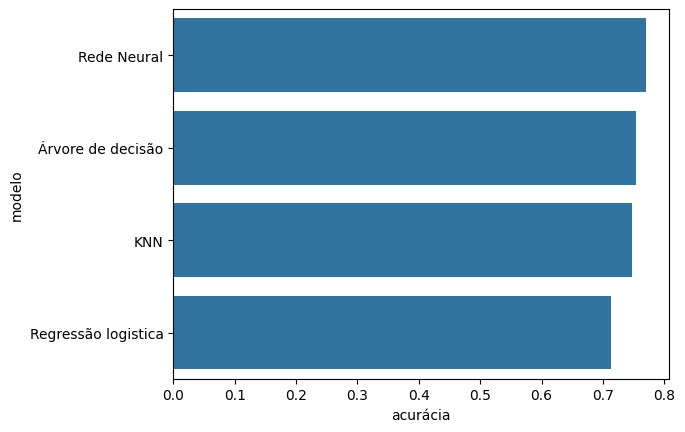

In [55]:
import seaborn as sns

sns.barplot(x = "acurácia", y = "modelo", data = df)

A rede neural obteve a melhor acurácia, entratanto como a base de dados é desbalanceada também serão realizadas outras análises.

## Matriz de confusão

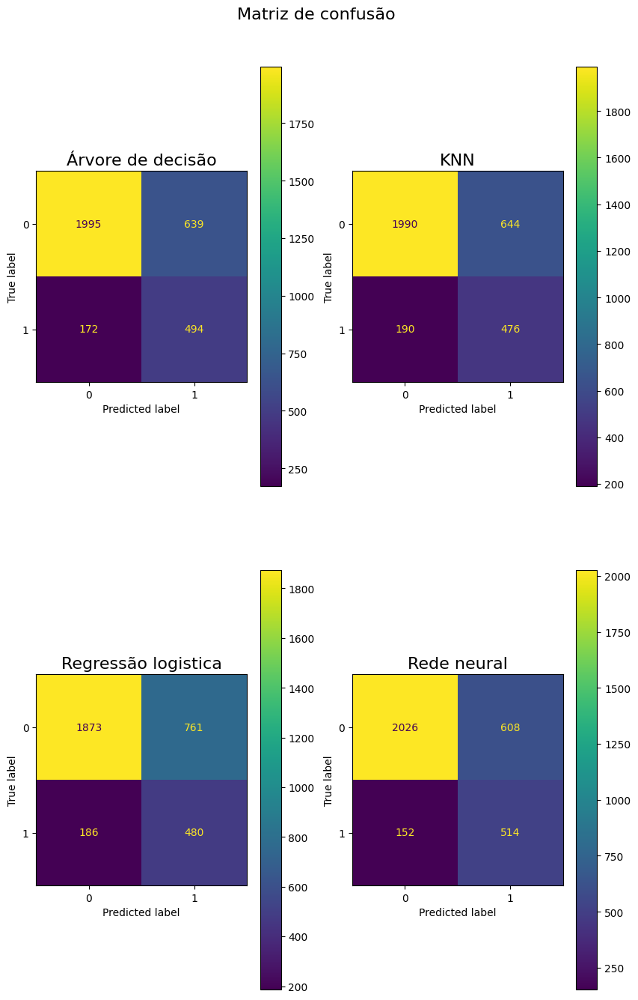

In [56]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

title_size = 16

f, axes = plt.subplots(2, 2, figsize=(10, 16))

axes[0, 0].set_title("Árvore de decisão", size=title_size)
cm = confusion_matrix(Y_test, Y_pred_dt, labels=dt_model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=dt_model.classes_)
disp.plot(values_format='', ax=axes[0, 0])

axes[0, 1].set_title("KNN", size=title_size)
cm = confusion_matrix(Y_test, Y_pred_knn, labels=knn_model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=knn_model.classes_)
disp.plot(values_format='', ax=axes[0, 1])

axes[1, 0].set_title("Regressão logistica", size=title_size)
cm = confusion_matrix(Y_test, Y_pred_lr, labels=lr_model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=lr_model.classes_)
disp.plot(values_format='', ax=axes[1, 0])

axes[1, 1].set_title("Rede neural", size=title_size)
cm = confusion_matrix(Y_test, Y_pred_mlp, labels=mlp_model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=mlp_model.classes_)
disp.plot(values_format='',ax=axes[1, 1])

f.suptitle("Matriz de confusão", size=title_size, y=0.93)
plt.show()

A rede neural obteve os melhores resultados, com uma menor quantidade de falsos positivos e falsos negativos na base de teste, enquanto a regressão logistica teve a maior quantidade de falsos positivos e o KNN a maior quantidade de falsos negativos.

## Curva ROC

<Figure size 640x480 with 0 Axes>

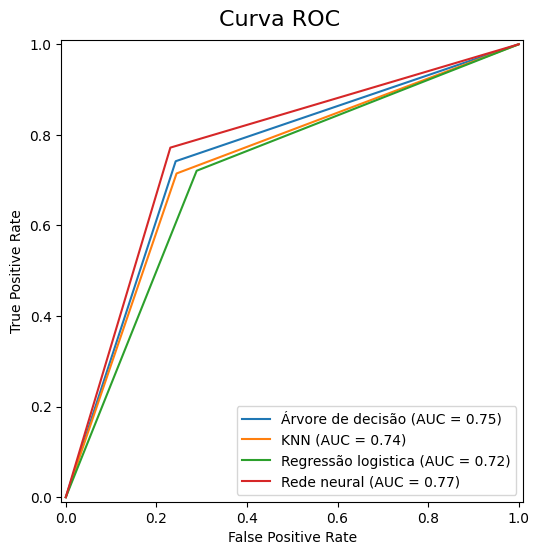

In [57]:
from sklearn.metrics import RocCurveDisplay, auc, roc_curve

plt.clf()


fpr, tpr, thresholds = roc_curve(Y_test, Y_pred_dt)
roc_auc = auc(fpr, tpr)
display_dt = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name = "Árvore de decisão")

fpr, tpr, thresholds = roc_curve(Y_test, Y_pred_knn)
roc_auc = auc(fpr, tpr)
display_knn = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name = "KNN")


fpr, tpr, thresholds = roc_curve(Y_test, Y_pred_lr)
roc_auc = auc(fpr, tpr)
display_lr = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name = "Regressão logistica")


fpr, tpr, thresholds = roc_curve(Y_test, Y_pred_mlp)
roc_auc = auc(fpr, tpr)
display_mlp = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name = "Rede neural")


f = plt.figure(figsize=(10,6))
f.suptitle("Curva ROC", size=title_size, y=0.93)

ax = plt.gca()

display_dt.plot(ax=ax)
display_knn.plot(ax=ax)
display_lr.plot(ax=ax)
display_mlp.plot(ax=ax)

plt.show()

A rede neural obteve o maior valor para a área sob a curva ROC.

## Curva Precisão Recall

<Figure size 640x480 with 0 Axes>

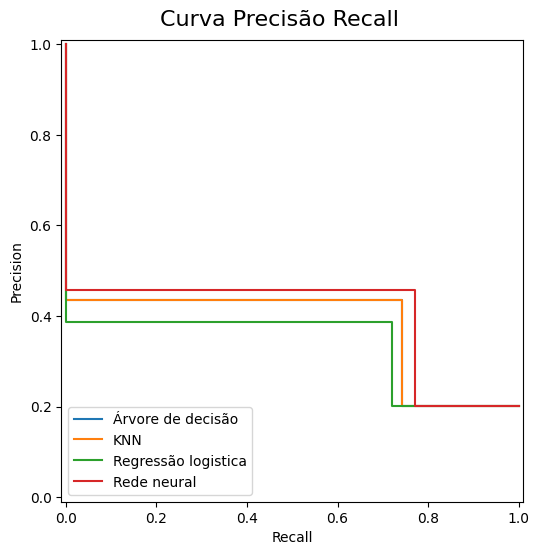

In [58]:
from sklearn.metrics import PrecisionRecallDisplay, precision_recall_curve

plt.clf()


precision, recall, _ = precision_recall_curve(Y_test, Y_pred_dt)
display_dt = PrecisionRecallDisplay(precision=precision, recall=recall,estimator_name = "Árvore de decisão")

fpr, tpr, thresholds = precision_recall_curve(Y_test, Y_pred_knn)
display_knn = PrecisionRecallDisplay(precision=precision, recall=recall,  estimator_name = "KNN")


precision, recall, _ = precision_recall_curve(Y_test, Y_pred_lr)
display_lr = PrecisionRecallDisplay(precision=precision, recall=recall,  estimator_name = "Regressão logistica")


precision, recall, _ = precision_recall_curve(Y_test, Y_pred_mlp)
display_mlp = PrecisionRecallDisplay(precision=precision, recall=recall,  estimator_name = "Rede neural")


f = plt.figure(figsize=(10,6))
f.suptitle("Curva Precisão Recall", size=title_size, y=0.93)

ax = plt.gca()

display_dt.plot(ax=ax)
display_knn.plot(ax=ax)
display_lr.plot(ax=ax)
display_mlp.plot(ax=ax)

plt.show()

Devido a base de dados ser desbalanceada, também foi analisada a área sob a curva precisão recall, de forma geral, devido a grande quantidade de falsos positivos que pode ser observada na matriz de confusão, a curva obtida para todos os modelos não é ideal, porém a rede neural, assim como nas analises anteriores, foi o modelo que obteve o melhor resultado.

# Incerteza

## Calculando a incerteza de cada modelo

In [252]:
import numpy as np

In [253]:
dt_inc = (1-np.amax(Y_pred_dt_proba, axis=1))
knn_inc = (1-np.amax(Y_pred_knn_proba, axis=1))
lr_inc = (1-np.amax(Y_pred_lr_proba, axis=1))
mlp_inc = (1-np.amax(Y_pred_mlp_proba, axis=1))

In [254]:
dt_inc_avg = dt_inc.mean()
knn_inc_avg = knn_inc.mean()
lr_inc_avg = lr_inc.mean()
mlp_inc_avg = mlp_inc.mean()

In [255]:
import pandas as pd

df_inc = pd.DataFrame()

df_inc["incerteza media"] = [dt_inc_avg, knn_inc_avg, lr_inc_avg, mlp_inc_avg]
df_inc["modelo"] = ["Árvore de decisão", "KNN", "Regressão logistica", "Rede Neural"] 

In [256]:
df_inc = df_inc.sort_values(by = "incerteza media")

In [257]:
df_inc["incerteza media"] = df_inc["incerteza media"].round(4)

In [258]:
df_inc

,incerteza media,modelo
0,0.2048,Árvore de decisão
3,0.2204,Rede Neural
1,0.3028,KNN
2,0.3138,Regressão logistica


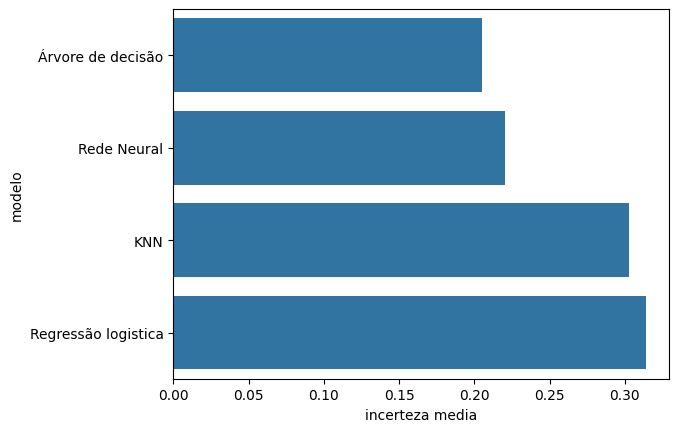

In [259]:
import seaborn as sns

ax = sns.barplot(df_inc, x="incerteza media", y="modelo")


A árvore de decisão foi o modelo que obteve a menor incerteza média entre as instâncias, com um valor de 0,2048, a rede neural obteve um valor próximo, 0,2204, porem o KNN e regressão logisticas foram mais incertos, com uma incerteza média de 0,3028 e 0,3138 respectivamente.

## Analisando a incerteza

[Text(0.5, 1.0, 'Incerteza árvore de decisão')]

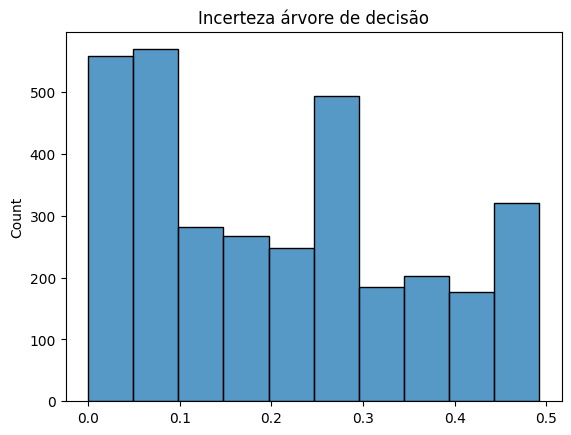

In [260]:
sns.histplot(data=dt_inc, bins=10).set(title = "Incerteza árvore de decisão")

[Text(0.5, 1.0, 'Incerteza regressão logística')]

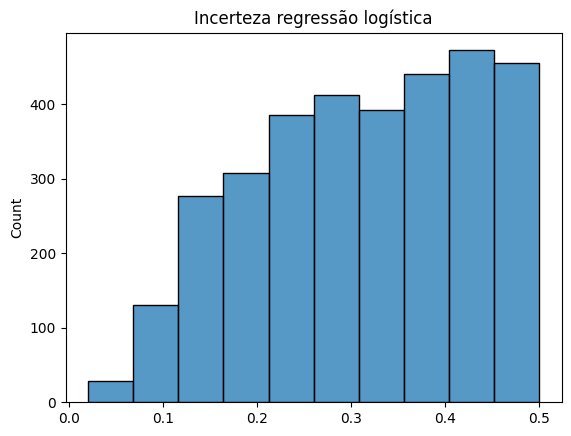

In [261]:
sns.histplot(data=lr_inc, bins=10).set(title = "Incerteza regressão logística")

[Text(0.5, 1.0, 'Incerteza KNN')]

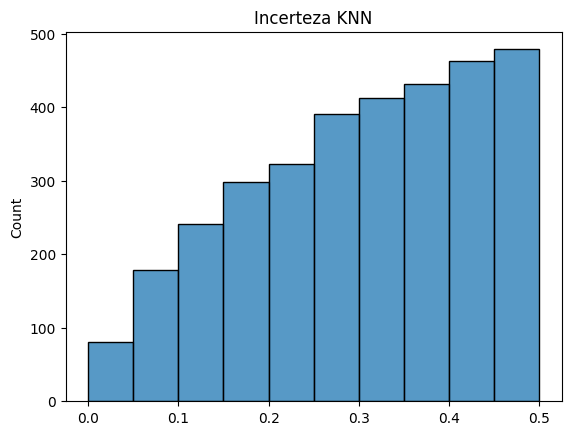

In [262]:
sns.histplot(data=knn_inc, bins = 10).set(title = "Incerteza KNN")

[Text(0.5, 1.0, 'Incerteza rede neural')]

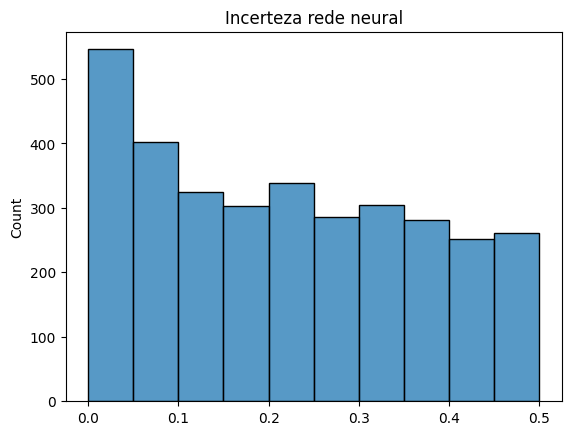

In [263]:
sns.histplot(data=mlp_inc, bins = 10).set(title = "Incerteza rede neural")

Atráves do histograma das incertezas das intâncias da base de teste,observa-se que o KNN e a regressão logística possuem uma maior quantidade de instâncias com uma alta incerteza. Na regressão logística a quantidade de instância com uma incerteza proxima a zero é ainda menor que a do KNN, se mostrando o modelo mais incerto.

## Analisando a incerteza de cada instância 

A incerteza aleatória será estimada utilizando a média da incerteza entre os modelos para cade instância, já para a incerteza epistêmica será utilizado a variância.

In [264]:
all_inc_mean = []
all_inc_var = []

for i in range(len(X_test)):
    all_inc_mean.append(np.array([dt_inc[i], knn_inc[i], lr_inc[i], mlp_inc[i]]).mean())
    all_inc_var.append(np.array([dt_inc[i], knn_inc[i], lr_inc[i], mlp_inc[i]]).var())

In [265]:
inc_df = pd.DataFrame()

inc_df["arvore_inc"] = dt_inc
inc_df["knn_inc"] = knn_inc
inc_df["regressao_log_inc"] = lr_inc
inc_df["rede_neural_inc"] = mlp_inc

inc_df["aleatoria"] = all_inc_mean
inc_df["epistemica"] = all_inc_var

[Text(0.5, 1.0, 'Incerteza aleatória')]

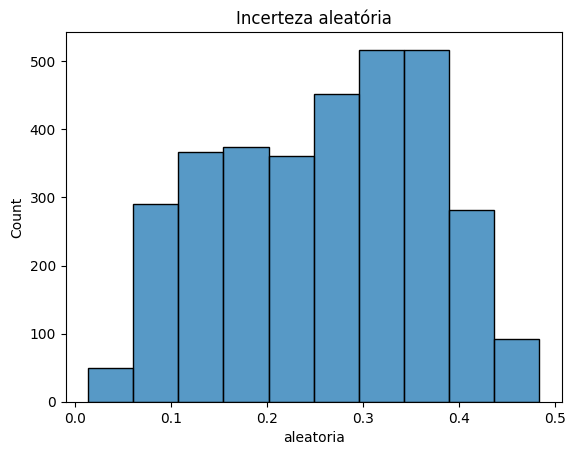

In [266]:
sns.histplot(data=inc_df["aleatoria"], bins = 10).set(title = "Incerteza aleatória")

In [267]:
inc_df.sort_values(by = "aleatoria", ascending = False).head(20)

,arvore_inc,knn_inc,regressao_log_inc,rede_neural_inc,aleatoria,epistemica
38,0.485714,0.491241,0.494139,0.464209,0.483826,0.000137
2602,0.492063,0.486751,0.465198,0.484423,0.482109,0.000103
75,0.492063,0.469758,0.468876,0.493485,0.481045,0.000138
969,0.485714,0.482154,0.461031,0.491321,0.480055,0.000131
2704,0.492063,0.455004,0.477653,0.492905,0.479406,0.000235
342,0.492063,0.483627,0.456369,0.477042,0.477275,0.000174
3174,0.492063,0.416631,0.492635,0.498346,0.474919,0.001139
1884,0.486486,0.448972,0.492444,0.454729,0.470658,0.000362
1946,0.432692,0.483777,0.479222,0.479529,0.468805,0.000438
957,0.492063,0.496010,0.392005,0.495010,0.468772,0.001967


Existe uma quantidade consideravel de instâncias com uma alta incerteza aleatória, serão realizadas analises para entender quais features causam essa incerteza nos modelos.

[Text(0.5, 1.0, 'Incerteza epistêmica')]

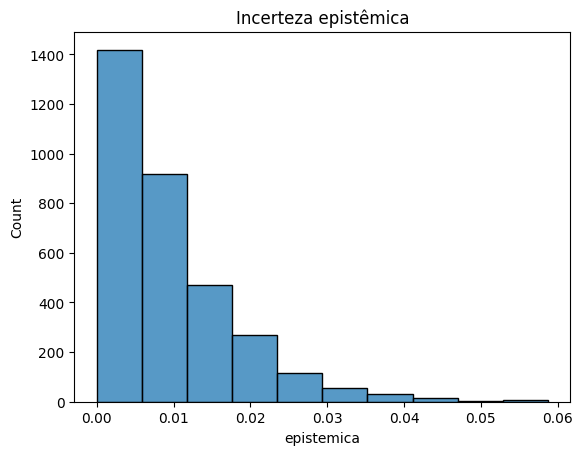

In [268]:
sns.histplot(data=inc_df["epistemica"], bins = 10).set(title = "Incerteza epistêmica")

In [269]:
inc_df.sort_values(by = "epistemica", ascending = False).head(20)

,arvore_inc,knn_inc,regressao_log_inc,rede_neural_inc,aleatoria,epistemica
2764,0.0,0.492606,0.486333,0.009848,0.247197,0.058713
3228,0.0,0.492608,0.474009,0.002162,0.242195,0.058180
1631,0.0,0.464858,0.488572,0.006895,0.240081,0.056072
734,0.0,0.497097,0.444849,0.004019,0.236491,0.055325
2050,0.0,0.499006,0.459889,0.027237,0.246533,0.054533
2749,0.0,0.417133,0.487267,0.002729,0.226782,0.051429
2073,0.0,0.485347,0.420730,0.009771,0.228962,0.050744
1501,0.0,0.480581,0.493418,0.124366,0.274591,0.047071
3123,0.0,0.395191,0.470983,0.022760,0.222234,0.045242
347,0.0,0.408946,0.449343,0.012641,0.217733,0.044919


Existe uma baixa quantidade de instância com uma alta incerteza epistêmica, ou seja, os modelos de modo geral possuem incertezas próximas para cada instância. Para as instâncias com uma alta incerteza epistêmica observa-se que geralmente a rede neural e a árvore de decisão possuem uma baixa incerteza, enquanto a regressão logística e  o KNN possuem uma alta incerteza.

# Analisando a causa das incertezas 

## Incerteza aleatória

In [604]:
inc_df

,arvore_inc,knn_inc,regressao_log_inc,rede_neural_inc,aleatoria,epistemica
0,0.000000,0.068903,0.216950,0.027226,0.078270,0.007013
1,0.200000,0.444627,0.499857,0.296566,0.360263,0.014086
2,0.454545,0.264536,0.299720,0.315989,0.333698,0.005214
3,0.295775,0.172698,0.214556,0.416953,0.274996,0.008675
4,0.222222,0.411093,0.498380,0.419372,0.387767,0.010296
...,...,...,...,...,...,...
3295,0.000000,0.163052,0.089853,0.031869,0.071194,0.003850
3296,0.200000,0.490183,0.462800,0.436614,0.397399,0.013348
3297,0.261628,0.465708,0.443655,0.464748,0.408935,0.007311
3298,0.485714,0.452652,0.295547,0.213524,0.361859,0.012496


Para analisar a causa da incerteza aleátoria serão selecionados 21 instância com uma alta incerteza e 21 com um baixa incerteza.

In [568]:
h_alea = inc_df[inc_df["aleatoria"] > 0.45].sort_values(ascending = False, by = "aleatoria").head(21).index

In [569]:
l_alea = inc_df[inc_df["aleatoria"] < 0.05].sort_values(ascending = False, by = "aleatoria").head(21).index

In [570]:
h_inc_alea_df = X_test.iloc[h_alea]

In [635]:
h_inc_alea_df.describe()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Male,Germany,Spain
count,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000
mean,637.904762,36.428571,5.857143,138621.081905,1.095238,0.571429,0.333333,119940.503333,0.333333,0.142857,0.333333
std,115.250121,5.343888,2.743824,22849.585855,0.300793,0.507093,0.483046,57025.706466,0.483046,0.358569,0.483046
min,468.000000,29.000000,1.000000,97588.600000,1.000000,0.000000,0.000000,19482.500000,0.000000,0.000000,0.000000
25%,565.000000,32.000000,4.000000,122874.740000,1.000000,0.000000,0.000000,83844.790000,0.000000,0.000000,0.000000
50%,621.000000,36.000000,6.000000,140596.950000,1.000000,1.000000,0.000000,124210.530000,0.000000,0.000000,0.000000
75%,737.000000,40.000000,8.000000,153880.150000,1.000000,1.000000,1.000000,166472.810000,1.000000,0.000000,1.000000
max,850.000000,51.000000,10.000000,179581.310000,2.000000,1.000000,1.000000,198714.290000,1.000000,1.000000,1.000000


In [571]:
l_inc_alea_df = X_test.iloc[l_alea]

In [636]:
l_inc_alea_df.describe()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Male,Germany,Spain
count,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000
mean,689.428571,50.666667,5.190476,86523.800000,1.571429,0.619048,0.285714,100163.625238,0.428571,0.666667,0.047619
std,90.831477,20.110528,2.786020,66439.472561,0.810643,0.497613,0.462910,63227.603152,0.507093,0.483046,0.218218
min,472.000000,18.000000,1.000000,0.000000,1.000000,0.000000,0.000000,2605.650000,0.000000,0.000000,0.000000
25%,622.000000,30.000000,3.000000,0.000000,1.000000,0.000000,0.000000,47799.150000,0.000000,0.000000,0.000000
50%,720.000000,59.000000,5.000000,113317.100000,1.000000,1.000000,0.000000,102628.560000,0.000000,1.000000,0.000000
75%,756.000000,63.000000,7.000000,136525.990000,2.000000,1.000000,1.000000,148887.690000,1.000000,1.000000,0.000000
max,808.000000,77.000000,10.000000,190353.080000,4.000000,1.000000,1.000000,199454.370000,1.000000,1.000000,1.000000


A principal diferença observada entre as instâncias com uma alta incerteza para as com menor incerteza é a idade, onde o grupo com menor incerteza possui uma grande quantidade de clientes mais velhos, e a maior presença de pessoas com a feature Germany igual a 1.

De forma a entender o porque das intâncias possuirem uma alta incerteza aléatora será gerada uma instancia que represente aquelas com maior incerteza e uma para as com menor incerteza, para isso será utilizada a mediana de cada feature.

In [509]:
cat = ["HasCrCard", "IsActiveMember", "Male", "Germany", "Spain"]

In [606]:
l_values = []
h_values = []

for col in X.columns:
    
    if X.dtypes[col] == "int64" or X.dtypes[col] == "uint8":
        l_values.append(l_inc_alea_df[col].median().round(0).astype(X.dtypes[col]))
        h_values.append(h_inc_alea_df[col].median().round(0).astype(X.dtypes[col]))
    else:
        l_values.append(l_inc_alea_df[col].median().astype(X.dtypes[col]))
        h_values.append(h_inc_alea_df[col].median().astype(X.dtypes[col]))
    
h_art_sample = pd.DataFrame([h_values], columns = h_inc_alea_df.columns)
l_art_sample = pd.DataFrame([l_values], columns = l_inc_alea_df.columns)

Intância artifical com alta incerteza:

In [633]:
h_art_sample

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Male,Germany,Spain
0,621,36,6,140596.95,1,1,0,124210.53,0,0,0


Instância artificial com baixa incerteza:

In [634]:
l_art_sample

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Male,Germany,Spain
0,720,59,5,113317.1,1,1,0,102628.56,0,1,0


### Verificando a probabilidade das instâncias geradas

In [617]:
h_mlp_inc = 1 - np.amax(mlp_pipe.predict_proba(h_art_sample))
h_dt_inc = 1- np.amax(dt_pipe.predict_proba(h_art_sample))
h_lr_inc = 1- np.amax(lr_pipe.predict_proba(h_art_sample))
h_knn_inc = 1- np.amax(knn_pipe.predict_proba(h_art_sample))

In [624]:

prob = {
    "modelo" : ["rede neural", "árvore de decisão",  "regressão logística", "knn"],
    "prob" : [h_mlp_inc,  h_dt_inc, h_lr_inc, h_knn_inc]
}

h_prob_df = pd.DataFrame(prob)

<Axes: xlabel='prob', ylabel='modelo'>

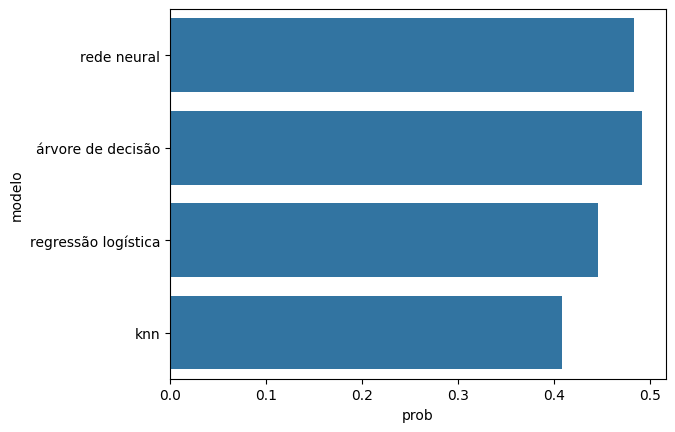

In [625]:
sns.barplot(data = h_prob_df, x = "prob", y = "modelo")

In [626]:
l_mlp_inc = 1 - np.amax(mlp_pipe.predict_proba(l_art_sample))
l_dt_inc = 1 - np.amax(dt_pipe.predict_proba(l_art_sample))
l_lr_inc = 1- np.amax(lr_pipe.predict_proba(l_art_sample))
l_knn_inc = 1- np.amax(knn_pipe.predict_proba(l_art_sample))

In [627]:

prob = {
    "modelo" : ["rede neural", "árvore de decisão",  "regressão logística", "knn"],
    "prob" : [l_mlp_inc,  l_dt_inc, l_lr_inc, l_knn_inc]
}

l_prob_df = pd.DataFrame(prob)

<Axes: xlabel='prob', ylabel='modelo'>

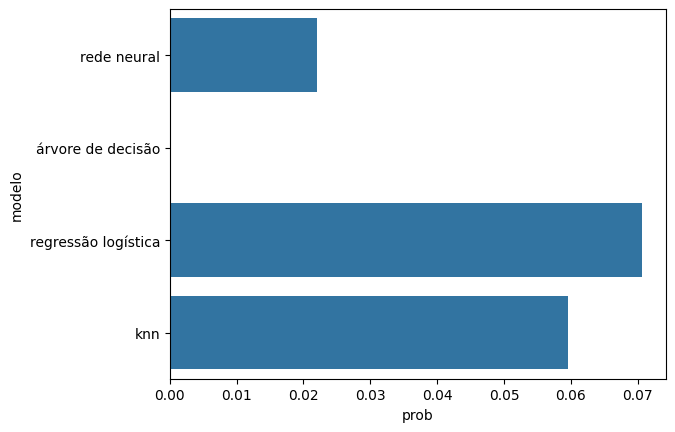

In [628]:
sns.barplot(data = l_prob_df, x = "prob", y = "modelo")

### Analisando as instâncias com o LIME

Para analisar a contribuição de cada feature na probabilidade será utilizado o LIME.

In [537]:
from lime.lime_tabular import LimeTabularExplainer

In [538]:
cat_idx = []

for idx, col in enumerate(X.columns):
    if col in cat:
        cat_idx.append(idx)

In [539]:
explainer = LimeTabularExplainer(
    training_data=X_train.values,
    mode="classification",
    training_labels=Y_train,
    feature_names=X.columns,
    categorical_features=cat_idx,
    random_state=42
)

#### Instância com alta incerteza

##### Árvore de decisão

In [629]:
exp = explainer.explain_instance(h_art_sample.iloc[0], dt_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


##### Regressão logística

In [643]:
exp = explainer.explain_instance(h_art_sample.iloc[0], lr_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


##### KNN

In [644]:
exp = explainer.explain_instance(h_art_sample.iloc[0], knn_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


##### Rede Neural

In [645]:
exp = explainer.explain_instance(h_art_sample.iloc[0], mlp_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [606]:
l_values = []
h_values = []

for col in X.columns:
    
    if X.dtypes[col] == "int64" or X.dtypes[col] == "uint8":
        l_values.append(l_inc_alea_df[col].median().round(0).astype(X.dtypes[col]))
        h_values.append(h_inc_alea_df[col].median().round(0).astype(X.dtypes[col]))
    else:
        l_values.append(l_inc_alea_df[col].median().astype(X.dtypes[col]))
        h_values.append(h_inc_alea_df[col].median().astype(X.dtypes[col]))
    
h_art_sample = pd.DataFrame([h_values], columns = h_inc_alea_df.columns)
l_art_sample = pd.DataFrame([l_values], columns = l_inc_alea_df.columns)

#### Instância com baixa incerteza

##### Árvore de decisão

In [646]:
exp = explainer.explain_instance(l_art_sample.iloc[0], dt_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


##### Regressão logística

In [648]:
exp = explainer.explain_instance(l_art_sample.iloc[0], lr_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


##### KNN

In [649]:
exp = explainer.explain_instance(l_art_sample.iloc[0], knn_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


##### Rede Neural

In [652]:
exp = explainer.explain_instance(l_art_sample.iloc[0], knn_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


#### Comentarios acerca do LIME

As features contribuem de forma semelhante entre os modelos para cada instância, já entre as instâncias, a principal diferença observada entre as instâncias é que de acordo com o LIME, idades superiores a 47 anos (Age) e ser da Alemanha (Germany) contribuem para a probabilidade de Churn, enquanto idades inferiores e não ser da Alemanha contribuem para a probabilidade da classe 0, ou seja, não dar Churn. Comparando as duas instâncias observa-se que as demais features com contribuições significativasm como por exemplo NumOfProducts e IsAciveMember contribuem para a mesma classe (classe 1), desta maneira, como as features Age e Germany nas instâncias com alta incerteza contribuem para a classe 0, isso faz com que a probabilidade da classe 0 aumente ficando próxima da classe 1, ocasionando assim o aumento da incerteza do modelo.

### Analise do PDP

Também será verificado a contribuição destas duas features por meio do Partial Dependency Plot (PDP)

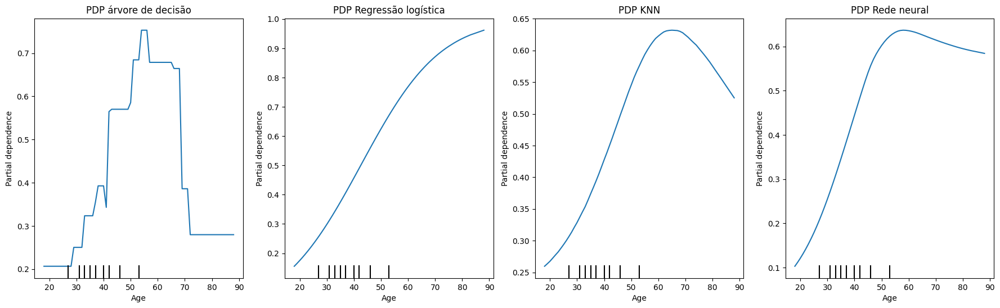

In [653]:
from sklearn.inspection import PartialDependenceDisplay

fig, axs = plt.subplots(1,4, figsize=(22, 6))

axs[0].set_title("PDP árvore de decisão")
disp1 = PartialDependenceDisplay.from_estimator(dt_pipe, X_test, ["Age"], ax = axs[0], n_jobs = -1)
axs[1].set_title("PDP Regressão logística")
disp1 = PartialDependenceDisplay.from_estimator(lr_pipe, X_test, ["Age"], ax = axs[1], n_jobs = -1)
axs[2].set_title("PDP KNN")
disp1 = PartialDependenceDisplay.from_estimator(knn_pipe, X_test, ["Age"], ax = axs[2], n_jobs = -1)
axs[3].set_title("PDP Rede neural")
disp1 = PartialDependenceDisplay.from_estimator(mlp_pipe, X_test, ["Age"], ax = axs[3], n_jobs = -1)


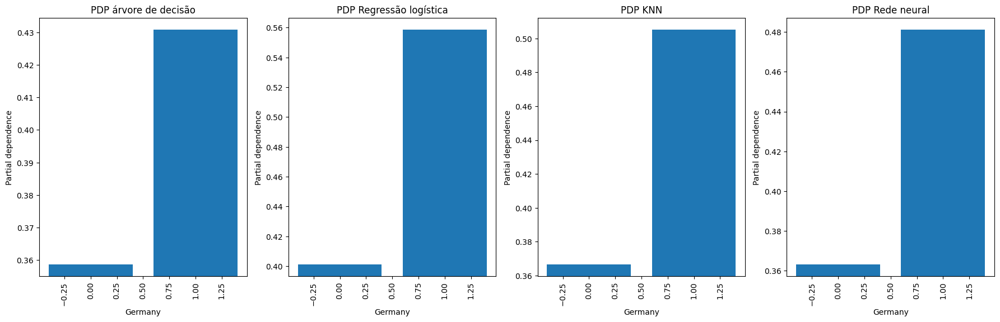

In [655]:
from sklearn.inspection import PartialDependenceDisplay

fig, axs = plt.subplots(1,4, figsize=(22, 6))

axs[0].set_title("PDP árvore de decisão")
disp1 = PartialDependenceDisplay.from_estimator(dt_pipe, X_test, ["Germany"], ax = axs[0], n_jobs = -1, categorical_features =  ["Germany"])
axs[1].set_title("PDP Regressão logística")
disp1 = PartialDependenceDisplay.from_estimator(lr_pipe, X_test, ["Germany"], ax = axs[1], n_jobs = -1, categorical_features =  ["Germany"])
axs[2].set_title("PDP KNN")
disp1 = PartialDependenceDisplay.from_estimator(knn_pipe, X_test, ["Germany"], ax = axs[2], n_jobs = -1, categorical_features =  ["Germany"])
axs[3].set_title("PDP Rede neural")
disp1 = PartialDependenceDisplay.from_estimator(mlp_pipe, X_test, ["Germany"], ax = axs[3], n_jobs = -1, categorical_features =  ["Germany"])


A diferença apontada pelo LIME também é observada no PDP, exite uma grande diferença na probabilidade que os modelos atribuem dependendo da idade, sendo menor para idade menores. Também existe uma diferença na feature Germany, os modelos atribuem uma maior probabilidade de Churn quando esta feature é 1. Desta forma, a incerteza aleatória ocorre quando os modelos atribuem probabilidades semelhantes de acordo com os valores das features de uma mesma instância e nas features que contribuem mais significadamente, possuem features com valores que contribuem para a classe 0 e features que possuem valores que contribuem para a classe 1, ocorrendo assim um equilibrio na probabilidade atribuida para cada classe.

## Incerteza epistêmica

In [670]:
a_inc_epis = inc_df.sort_values(by = "epistemica", ascending= False).head(21)

In [672]:
a_epis = a_inc_epis.index

In [673]:
a_inc_epis_df = X_test.iloc[a_epis]

In [669]:
a_inc_epis_df.describe()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Male,Germany,Spain
count,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.00000,20.000000
mean,638.900000,44.500000,6.050000,81352.505500,2.850000,0.550000,0.600000,96097.552000,0.300000,0.35000,0.200000
std,102.521833,9.864877,2.684752,57104.290145,0.587143,0.510418,0.502625,52544.318132,0.470162,0.48936,0.410391
min,415.000000,28.000000,2.000000,0.000000,1.000000,0.000000,0.000000,3966.500000,0.000000,0.00000,0.000000
25%,576.250000,38.750000,3.000000,33226.072500,3.000000,0.000000,0.000000,60946.195000,0.000000,0.00000,0.000000
50%,657.000000,45.500000,6.000000,89155.950000,3.000000,1.000000,1.000000,86784.330000,0.000000,0.00000,0.000000
75%,708.750000,50.000000,9.000000,134363.922500,3.000000,1.000000,1.000000,137675.757500,1.000000,1.00000,0.000000
max,771.000000,72.000000,10.000000,164769.020000,4.000000,1.000000,1.000000,179258.670000,1.000000,1.00000,1.000000


In [675]:
a_values = []

for col in X.columns:
    
    if X.dtypes[col] == "int64" or X.dtypes[col] == "uint8":
        a_values.append(a_inc_epis_df[col].median().round(0).astype(X.dtypes[col]))
    else:
        a_values.append(a_inc_epis_df[col].median().astype(X.dtypes[col]))
    
a_epis_art_sample = pd.DataFrame([a_values], columns = a_inc_epis_df.columns)


In [676]:
a_epis_art_sample

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Male,Germany,Spain
0,662,46,6,95813.76,3,1,1,87822.14,0,0,0


### Analisando com o LIME

#### Árvore de decisão

In [677]:
exp = explainer.explain_instance(a_epis_art_sample.iloc[0], dt_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


#### Regressão logística

In [678]:
exp = explainer.explain_instance(a_epis_art_sample.iloc[0], lr_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


#### KNN

In [679]:
exp = explainer.explain_instance(a_epis_art_sample.iloc[0], knn_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


#### Rede neural

In [680]:
exp = explainer.explain_instance(a_epis_art_sample.iloc[0], mlp_pipe.predict_proba, num_features = 11)
exp.show_in_notebook()

C:\Users\Victor\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


#### Comentários acerca do LIME

Nos modelos que possuem uma baixa incerteza, árvore de decisão e a rede neural, de acordo com o LIME, o valor 2 para a feature NumOfProducts possue uma alta contribuição para a classe 1, já no KNN essa contribuição é bem menor e na regressão logítica ela contribui para a classe 0.

### Analise do PDP

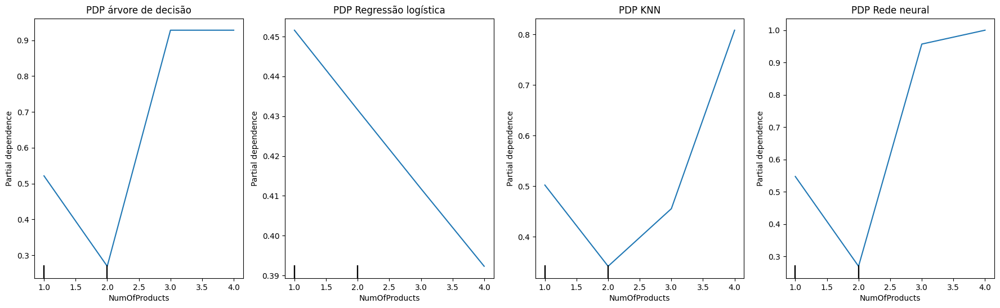

In [682]:
from sklearn.inspection import PartialDependenceDisplay

fig, axs = plt.subplots(1,4, figsize=(22, 6))

axs[0].set_title("PDP árvore de decisão")
disp1 = PartialDependenceDisplay.from_estimator(dt_pipe, X_test, ["NumOfProducts"], ax = axs[0], n_jobs = -1)
axs[1].set_title("PDP Regressão logística")
disp1 = PartialDependenceDisplay.from_estimator(lr_pipe, X_test, ["NumOfProducts"], ax = axs[1], n_jobs = -1)
axs[2].set_title("PDP KNN")
disp1 = PartialDependenceDisplay.from_estimator(knn_pipe, X_test, ["NumOfProducts"], ax = axs[2], n_jobs = -1)
axs[3].set_title("PDP Rede neural")
disp1 = PartialDependenceDisplay.from_estimator(mlp_pipe, X_test, ["NumOfProducts"], ax = axs[3], n_jobs = -1)


A árvore de decisão e a rede neural possuem curvas com formatos semelhantes para a feature NumOfProducts e esta feature é a que mais contribui para a classe 1, já a regressão logistica, atribue uma maior probabilidade de Churn para valores menores e diminui com o aumento do valor. No KNN observa-se que para o valor 3, quando comparado com a rede neural e a árvore de decisão, o modelo atribui uma probabilidade bem menor,e esse é o valor predominando nas instâncias com uma alta incerteza epistêmica.

### Analíse do PFI

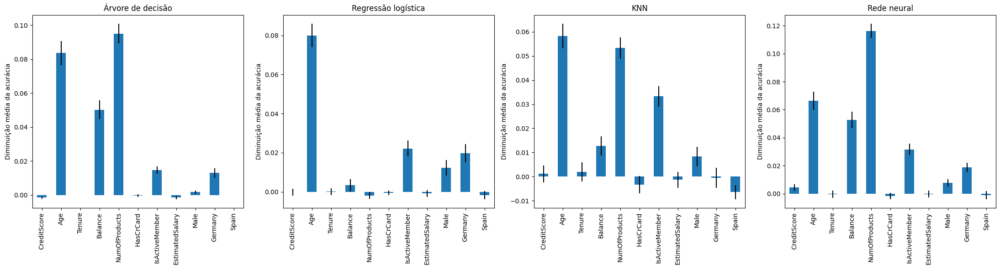

In [693]:
fig, axs = plt.subplots(1, 4, figsize=(22, 6))

dt_result = permutation_importance(dt_pipe, X_test, Y_test, n_repeats=30, random_state=42)
dt_importances = pd.Series(dt_result.importances_mean, index=X_test.columns)
dt_importances.plot.bar(yerr=dt_result.importances_std, ax=axs[0])
axs[0].set_title("Árvore de decisão")
axs[0].set_ylabel("Diminuição média da acurácia")

lr_result = permutation_importance(lr_pipe, X_test, Y_test, n_repeats=30, random_state=42)
lr_importances = pd.Series(lr_result.importances_mean, index=X_test.columns)
lr_importances.plot.bar(yerr=lr_result.importances_std, ax=axs[1])
axs[1].set_title("Regressão logística")
axs[1].set_ylabel("Diminuição média da acurácia")

knn_result = permutation_importance(knn_pipe, X_test, Y_test, n_repeats=30, random_state=42)
knn_importances = pd.Series(knn_result.importances_mean, index=X_test.columns)
knn_importances.plot.bar(yerr=knn_result.importances_std, ax=axs[2])
axs[2].set_title("KNN")
axs[2].set_ylabel("Diminuição média da acurácia")

mlp_result = permutation_importance(mlp_pipe, X_test, Y_test, n_repeats=30, random_state=42)
mlp_importances = pd.Series(mlp_result.importances_mean, index=X_test.columns)
mlp_importances.plot.bar(yerr=mlp_result.importances_std, ax=axs[3])
axs[3].set_title("Rede neural")
axs[3].set_ylabel("Diminuição média da acurácia")


fig.tight_layout()
plt.show()

A feature NumOfProducts é a mais importante para a árvore de decisão e a rede neural, já para o KNN essa importância é inferior e na regressão logística essa feature não possui importância significativa.

Desta forma, pode-se concluir que as diferentes formas que os modelos utilizam a feature NumOfProducts é a principal causa da incerteza epistêmica.

# Conclusão

Após as analises foi possivel observar que a incerteza aleatória ocorre quando as features com uma contruibuição significativa possuem valores que causam o aumento da probabilidade para as duas classes, no caso do comparativo entre as instâncias com uma alta incerteza dos com a uma baixa incerteza, as com alta incerteza possuem uma idade mais avançadas e são da alemanha, valores que possuem uma alta contribuição para a classe 0, acarretando em um equilibrio entre as probabilidades das duas classes.

Já a incerteza epistêmica, foi observado que é a principal causa é a feature NumOfProducts, onde a árvore de decisão e a rede neural utilizam a feature de forma semelhantes, enquanto o KNN e a regressão lógistica dão importâncias diferentes, não sendo muito relevante para a regressão logística e o KNN atribue uma probabilidade inferior a rede neural e a árvore de decisão quando o valor é 3, valor esse predominante nas instâncias com uma alta incerteza epistêmica.